In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory

import os
print(os.listdir("data"))

# Any results you write to the current directory are saved as output.

['train.csv', 'train_images', 'test.csv', 'test_images', 'sample_submission.csv']


In [2]:
import os, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import skimage.io
from skimage.transform import resize
from imgaug import augmenters as iaa
from tqdm import tqdm
import PIL
from PIL import Image, ImageOps
import cv2
from sklearn.utils import class_weight, shuffle
from keras.losses import binary_crossentropy
from keras.applications.resnet50 import preprocess_input
import keras.backend as K
import tensorflow as tf
from sklearn.metrics import f1_score, fbeta_score
from keras.utils import Sequence
from keras.utils import to_categorical
from sklearn.model_selection import train_test_split

WORKERS = 2
CHANNEL = 3

import warnings
warnings.filterwarnings("ignore")
IMG_SIZE = 512
NUM_CLASSES = 5
SEED = 77
TRAIN_NUM = 1000 # use 1000 when you just want to explore new idea, use -1 for full train


DATA_PATH = "data"

Using TensorFlow backend.


# 1. Introduction. Explore first, train later.

Hi everyone! As *Aravind Eye Hospital* is one of my favorite organization in the world; they take care of poor people's eyes for free with an impressive sustainable business model.  I will try my best to contribute something to our community. One intuitive way to improve the performance of our model is to simply improve the quality of input images. In this kernel, I will share two ideas which I hope may be useful to some of you : 

- **Decolorize images** : here as we will see, images come with many different lighting conditions, some images are quite dark and difficult to visualize. We can try to convert the image to gray scale, and visualize better. Alternatively, we can try the method of [Ben Graham (last competition's winner)](https://github.com/btgraham/SparseConvNet/tree/kaggle_Diabetic_Retinopathy_competition)
- **Cropping uninformative area** : everyone know this :) Here, I just find the codes from internet and choose the best one for you :)

We are going to apply both techniques to both the official data, and the past competition data (shout out @tanlikesmath for creating this dataset! https://www.kaggle.com/tanlikesmath/diabetic-retinopathy-resized . In the updated version, I also try @donkeys' dataset https://www.kaggle.com/donkeys/retinopathy-train-2015 , which is .png which may be have higer image quality than .jpeg format)

If I found more useful tricks, I will update the notebook, or if you have more useful tricks and would love to share, please let me know!

I use some parts of codes from @mathormad and @artgor kernels. Thanks both of you!

Now let us start by loading the train/test dataframes. The `train_test_split` here is in fact not necessary. But when I first fork the kernel from @mathormad, I found some interesting examples using this split and the current `SEED`, so I continue to use them here.

In [3]:
df_train = pd.read_csv(DATA_PATH + '/train.csv')
df_test = pd.read_csv(DATA_PATH + '/test.csv')

x = df_train['id_code']
y = df_train['diagnosis']

x, y = shuffle(x, y, random_state=SEED)


(3112,) (3112,) (550,) (550,)


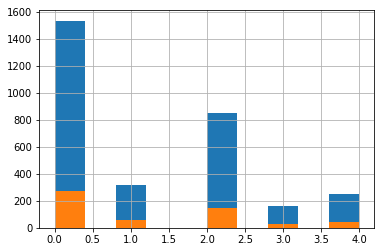

In [4]:
train_x, valid_x, train_y, valid_y = train_test_split(x, y, test_size=0.15,
                                                      stratify=y, random_state=SEED)
print(train_x.shape, train_y.shape, valid_x.shape, valid_y.shape)
train_y.hist()
valid_y.hist()

## 1.1 Simple picture to explain Diabetic Retinopathy

How do we know that a patient have diabetic retinopahy? There are 5 things to spot on. Image credit https://www.eyeops.com/
![credit : https://www.eyeops.com/](https://sa1s3optim.patientpop.com/assets/images/provider/photos/1947516.jpeg)

From quick investigations of the data (see various pictures below), I found that *Hemorrphages, Hard Exudates and Cotton Wool spots* are quite easily observed. However, I still could not find examples of *Aneurysm* or *Abnormal Growth of Blood Vessels* from our data yet. Perhaps the latter two cases are important if we want to catch up human benchmnark using our model.

## 1.2 Original Inputs

First, let have a glance of original inputs. Each row depicts each severity level. We can see two problems which make the severity difficult to spot on. First, some images are very dark [pic(0,2) and pic(4,4) ] and sometimes different color illumination is confusing [pic (3,3)]. Second, we can get the uninformative dark areas for some pictures [pic(0,1), pic(0,3)]. This is important when we reduce the picture size, as informative areas become too small. So it is intuitive to crop the uninformative areas out in the second case.

In [5]:
# Choose 5 random images one for each different diagnosis value

image_list = []
for class_id in sorted(train_y.unique()):
    image_list.append(df_train.loc[df_train['diagnosis'] == class_id].sample(1, random_state=SEED))

image_list

[           id_code  diagnosis
 1361  5ead17e894ae          0,            id_code  diagnosis
 3305  e580676516b0          1,           id_code  diagnosis
 520  2532613a584a          2,            id_code  diagnosis
 2200  9a94e0316ee3          3,          id_code  diagnosis
 88  07122e268a1d          4]

CPU times: user 3.79 s, sys: 20.9 ms, total: 3.81 s
Wall time: 841 ms


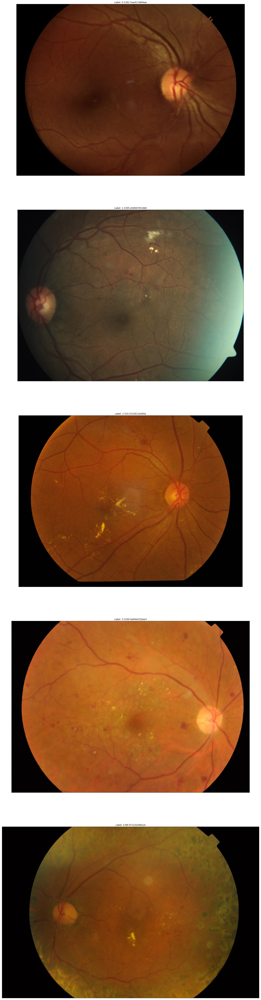

In [12]:
%%time

# those are the original images

fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image)
    ax.set_title('Label: %d-%s-%s' % (class_id, image_data.index[0] , image_data.iloc[0][0]) )
        


We can try gray scale and feel understand better for some pictures, as color distraction is gone. For example, we can see more blood clearer in the upper part of pic(4,4), which has severity of level 4.

CPU times: user 2.33 s, sys: 12.2 ms, total: 2.35 s
Wall time: 481 ms


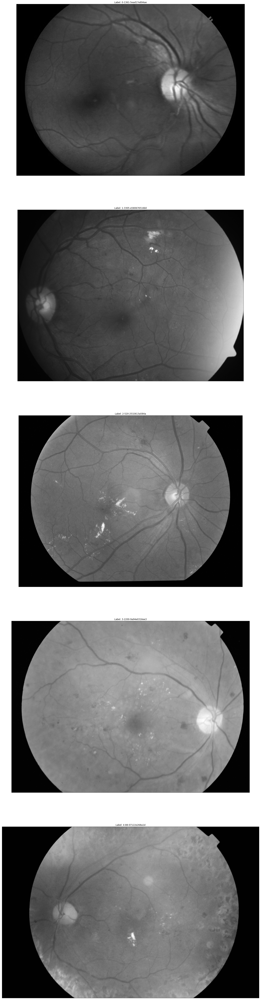

In [15]:
%%time
fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # supressing cmap, images are in blue-yellow and really contrasted
    plt.imshow(image ,cmap = "gray")
    ax.set_title('Label: %d-%s-%s' % (class_id, image_data.index[0] , image_data.iloc[0][0]) )
        

For severity level 4, I feel that two examples here are difficult to spot on, pic(4,1) and pic(4,4). As we try zooming to see the details (use real size image), we can see some abnormalities (*cotton wool spots* or *hard exudates* ?) in those eyes clearer (observe the lower-right part of the eye). Therefore, `IMG_SIZE` is definitely important for this problem.

2136 3216


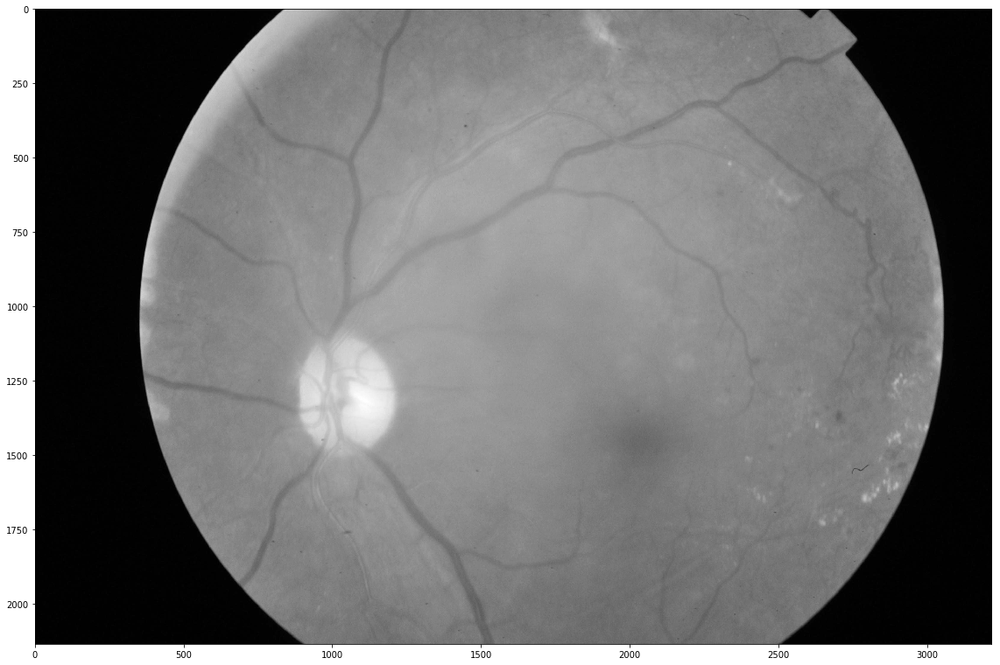

In [16]:
dpi = 80 #inch

# path=f"../input/aptos2019-blindness-detection/train_images/5c7ab966a3ee.png" # notice upper part
path=f"{DATA_PATH}/train_images/cd54d022e37d.png" # lower-right, this still looks not so severe, can be class3
image = cv2.imread(path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
height, width = image.shape
print(height, width)

SCALE=2
figsize = (width / float(dpi))/SCALE, (height / float(dpi))/SCALE

fig = plt.figure(figsize=figsize)
plt.imshow(image, cmap='gray')

# 2. Try Ben Graham's preprocessing method.

In the last competition, [Ben Graham (last competition's winner)](https://github.com/btgraham/SparseConvNet/tree/kaggle_Diabetic_Retinopathy_competition) share insightful way to improve lighting condition. Here, we apply his idea, and can see many important details in the eyes much better. For full details, please refer to his technical report in the link above.

CPU times: user 18.7 s, sys: 15.8 ms, total: 18.7 s
Wall time: 2.02 s


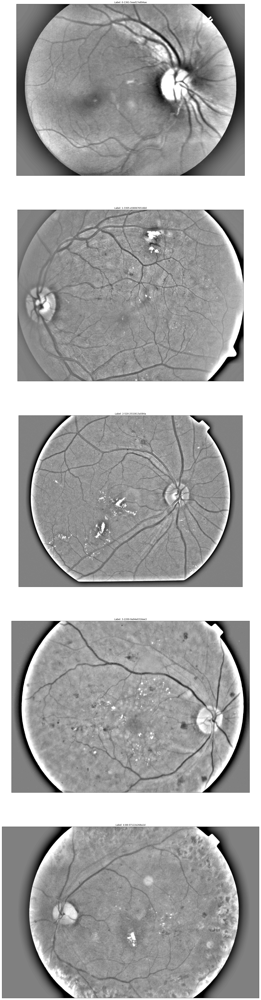

In [17]:
%%time
fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # this line is the Ben Graham's preprocessing
    image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10) ,-4 ,128) 
    # supressing cmap, images are in blue-yellow and really contrasted
    plt.imshow(image ,cmap = "gray")
    ax.set_title('Label: %d-%s-%s' % (class_id, image_data.index[0] , image_data.iloc[0][0]) )


CPU times: user 19 s, sys: 11.6 ms, total: 19 s
Wall time: 2.05 s


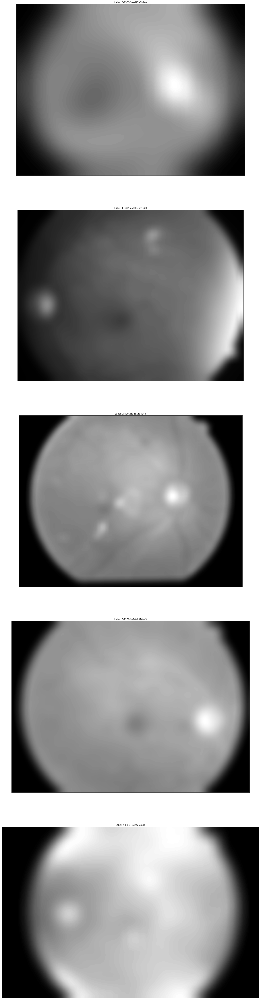

In [18]:
%%time
fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # this line is the Ben Graham's preprocessing
    # first obtain blurred image then adds wheigthed
    image = cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10)
    # image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10) ,-4 ,128) 
    # supressing cmap, images are in blue-yellow and really contrasted
    plt.imshow(image ,cmap = "gray")
    ax.set_title('Label: %d-%s-%s' % (class_id, image_data.index[0] , image_data.iloc[0][0]) )


CPU times: user 3.25 s, sys: 15.5 ms, total: 3.27 s
Wall time: 621 ms


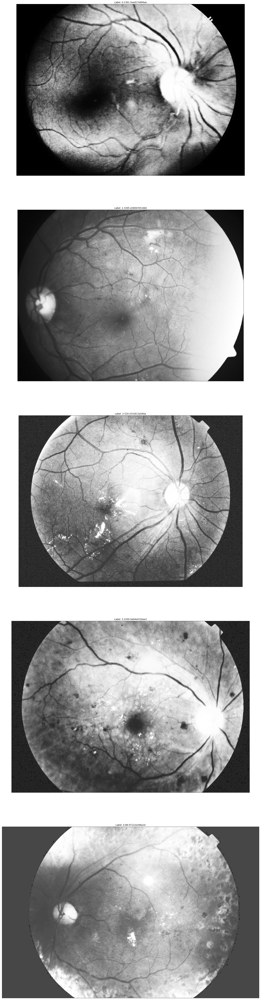

In [20]:
%%time
fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # with histogram equalization
    # first obtain image histogram
    # hist, bins = np.histogram(image.flatten(),256, [0,256])
    # cdf = hist.cumsum()
    # cdf_normalyzed = cdf* hist.max()/cdf.max()
    image = cv2.equalizeHist(image)
    plt.imshow(image ,cmap = "gray")
    ax.set_title('Label: %d-%s-%s' % (class_id, image_data.index[0] , image_data.iloc[0][0]) )


CPU times: user 2.61 s, sys: 19.8 ms, total: 2.63 s
Wall time: 501 ms


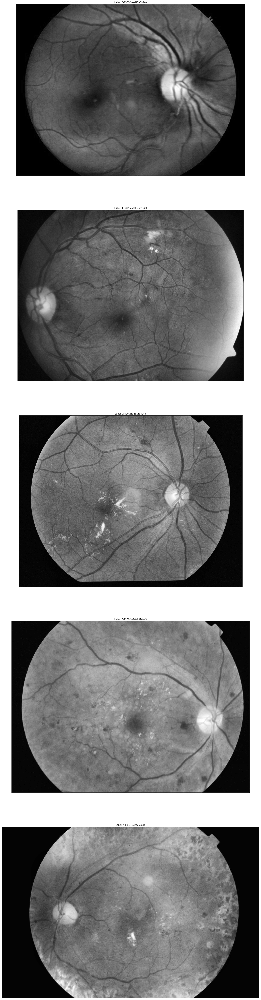

In [24]:
%%time
fig = plt.figure(figsize=(100, 100))

for image_data in image_list:
    class_id = int(image_data.iloc[0][1])
    ax = fig.add_subplot(5, 1, class_id +1, xticks=[], yticks=[])
    path=f"{DATA_PATH}/train_images/{image_data.iloc[0][0]}.png"
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # with adaptative histogram normalization
    # first obtain image histogram
    # hist, bins = np.histogram(image.flatten(),256, [0,256])
    # cdf = hist.cumsum()
    # cdf_normalyzed = cdf* hist.max()/cdf.max()
    
    # image = cv2.equalizeHist(image)
    
    # create a CLAHE object (Arguments are optional).
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(6,6))
    image = clahe.apply(image)
    
    plt.imshow(image ,cmap = "gray")
    ax.set_title('Label: %d-%s-%s' % (class_id, image_data.index[0] , image_data.iloc[0][0]) )


# 3. Further improve by auto-cropping

To crop out the uninformative black areas which are evident on pic(0,1), pic(0,3) and pic(4,1), we can try auto cropping. Here I found the following 4 alternative codes from https://stackoverflow.com/questions/13538748/crop-black-edges-with-opencv and https://codereview.stackexchange.com/questions/132914/crop-black-border-of-image-using-numpy/132934 ... Fortunately one method is work perfectly for us (gray-scale only). If anybody can fix a code to also auto-crop the image color, I would be appreciate :)


In [ ]:
def crop_image1(img,tol=8):
    # img is image data
    # tol  is tolerance
        
    mask = img>tol
    return img[np.ix_(mask.any(1),mask.any(0))]


In [ ]:
'''all of these do not work'''

def crop_image2(image,threshold=5):
    if len(image.shape) == 3:
        flatImage = np.max(image, 2)
    else:
        flatImage = image
    assert len(flatImage.shape) == 2

    rows = np.where(np.max(flatImage, 0) > threshold)[0]
    if rows.size:
        cols = np.where(np.max(flatImage, 1) > threshold)[0]
        image = image[cols[0]: cols[-1] + 1, rows[0]: rows[-1] + 1]
    else:
        image = image[:1, :1]

    return image

def crop_image3(image):
    mask = image > 0

    # Coordinates of non-black pixels.
    coords = np.argwhere(mask)

    # Bounding box of non-black pixels.
    x0, y0 = coords.min(axis=0)
    x1, y1 = coords.max(axis=0) + 1   # slices are exclusive at the top
    
    # Get the contents of the bounding box.
    cropped = image[x0:x1, y0:y1]
    return cropped

def crop_image4(image):
    _,thresh = cv2.threshold(image,1,255,cv2.THRESH_BINARY)
    contours,hierarchy = cv2.findContours(thresh,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    cnt = contours[0]
    x,y,w,h = cv2.boundingRect(cnt)
    crop = image[y:y+h,x:x+w]
    return crop



### Try Cropping the images

I have tested on around 200 images, and the method works great. However, if anybody find the outlier cases which cause the auto crop to fail, please let me know. I think now the eye pictures are very like the moon by the way :)

In [ ]:
%%time

NUM_SAMP=10
fig = plt.figure(figsize=(25, 16))
for class_id in sorted(train_y.unique()):
    for i, (idx, row) in enumerate(df_train.loc[df_train['diagnosis'] == class_id].sample(NUM_SAMP, random_state=SEED).iterrows()):
        ax = fig.add_subplot(5, NUM_SAMP, class_id * NUM_SAMP + i + 1, xticks=[], yticks=[])
        path=f"{DATA_PATH}/train_images/{row['id_code']}.png"
        image = cv2.imread(path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        image = crop_image1(image)
        image = cv2.resize(image, (IMG_SIZE, IMG_SIZE))
        image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10) ,-4 ,128)

        plt.imshow(image, cmap='gray')
        ax.set_title('%d-%d-%s' % (class_id, idx, row['id_code']) )

We can also try auto cropping on 50 test data to see that it work fine.

In [ ]:
%%time
NUM_SAMP=10
fig = plt.figure(figsize=(25, 16))
for jj in range(5):
    for i, (idx, row) in enumerate(df_test.sample(NUM_SAMP).iterrows()):
        ax = fig.add_subplot(5, NUM_SAMP, jj * NUM_SAMP + i + 1, xticks=[], yticks=[])
        path=f"{DATA_PATH}/test_images/{row['id_code']}.png"
        image = cv2.imread(path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        image = crop_image1(image)
        image = cv2.resize(image, (IMG_SIZE, IMG_SIZE))
        image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10) ,-4 ,128)

        plt.imshow(image, cmap='gray')
        ax.set_title('%d-%s' % (idx, row['id_code']) )

Lastly, we can try plotting a picture (sample train pic(4,1) above) with IMG_SIZE pic with cropping, now important information is much clearer to see

In [ ]:
dpi = 80 #inch

# path=f"../input/aptos2019-blindness-detection/train_images/5c7ab966a3ee.png" # notice upper part
path=f"{DATA_PATH}/train_images/cd54d022e37d.png" # lower-right, can be class3
image = cv2.imread(path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
image = crop_image1(image)
image = cv2.resize(image, (IMG_SIZE, IMG_SIZE))
image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10) ,-4 ,128)

height, width = IMG_SIZE, IMG_SIZE
print(height, width)

SCALE=1
figsize = (width / float(dpi))/SCALE, (height / float(dpi))/SCALE

fig = plt.figure(figsize=figsize)
plt.imshow(image, cmap='gray')

# 4. Try the same method to Past competition data
Thanks @tanlikesmath, https://www.kaggle.com/tanlikesmath/diabetic-retinopathy-resized who provides us a complete previous-competition dataset in the .jpeg format; this is much smaller than the original version with the risk of losing image details. Let apply both normal gray scale, and Ben Graham's method to this dataset.

In [ ]:
!ls ../input/diabetic-retinopathy-resized/

In [ ]:
!ls ../input/diabetic-retinopathy-resized/resized_train/resized_train | head

In [ ]:
df_old = pd.read_csv('../input/diabetic-retinopathy-resized/trainLabels.csv')

df_old.head()

In [ ]:
NUM_SAMP=10
fig = plt.figure(figsize=(25, 16))
for class_id in sorted(train_y.unique()):
    for i, (idx, row) in enumerate(df_old.loc[df_old['level'] == class_id].sample(NUM_SAMP, random_state=SEED).iterrows()):
        ax = fig.add_subplot(5, NUM_SAMP, class_id * NUM_SAMP + i + 1, xticks=[], yticks=[])
        path=f"../input/diabetic-retinopathy-resized/resized_train/resized_train/{row['image']}.jpeg"
        image = cv2.imread(path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        image = crop_image1(image)
        image = cv2.resize(image, (IMG_SIZE, IMG_SIZE))
        image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10) ,-4 ,128)

        plt.imshow(image, cmap='gray')
        ax.set_title('%d-%d-%s' % (class_id, idx, row['image']) )

In [ ]:
NUM_SAMP=10
fig = plt.figure(figsize=(25, 16))
for class_id in sorted(train_y.unique()):
    for i, (idx, row) in enumerate(df_old.loc[df_old['level'] == class_id].sample(NUM_SAMP, random_state=SEED).iterrows()):
        ax = fig.add_subplot(5, NUM_SAMP, class_id * NUM_SAMP + i + 1, xticks=[], yticks=[])
        path=f"../input/diabetic-retinopathy-resized/resized_train/resized_train/{row['image']}.jpeg"
        image = cv2.imread(path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        image = crop_image1(image)
        image = cv2.resize(image, (IMG_SIZE, IMG_SIZE))
#         image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10) ,-4 ,128)

        plt.imshow(image, cmap='gray')
        ax.set_title('%d-%d-%s' % (class_id, idx, row['image']) )

Ok preprocessing methods seem to works fine; however, the doctors to estimate the severity levels in the past competitions may have different criteria in mind than the doctors of Aravind, so it is possible to have some estimation inconsistency (at least to my eyes the previous data seems more noisy). The following level-4 [pic(4,1) in the plot we just made above] looks not so severe. (Or this is the example case of too many blood vessels ??, refer to Section 1.1)

In [ ]:
dpi = 80 #inch

path=f"../input/diabetic-retinopathy-resized/resized_train/resized_train/31590_right.jpeg" # too many vessels?
# path=f"../input/diabetic-retinopathy-resized/resized_train/resized_train/18017_left.jpeg" # details are lost
image = cv2.imread(path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
image = crop_image1(image)
image = cv2.resize(image, (IMG_SIZE, IMG_SIZE))
image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10) ,-4 ,128)

height, width = IMG_SIZE, IMG_SIZE
print(height, width)

SCALE=1
figsize = (width / float(dpi))/SCALE, (height / float(dpi))/SCALE

fig = plt.figure(figsize=figsize)
plt.imshow(image, cmap='gray')

## 4.1 Let us compare to the .png image.

Some pictures (e.g. pics (4,5-8)) seem to lost details perhaps this is due to .jpeg compression ? I don't think so, but at least we should try. Fortunately, @donkeys also provides us .png version of the previous competition.

In [ ]:
!ls ../input/retinopathy-train-2015/rescaled_train_896/rescaled_train_896/ | head

In [ ]:
dpi = 80 #inch

path_jpg=f"../input/diabetic-retinopathy-resized/resized_train/resized_train/18017_left.jpeg" # too many vessels?
path_png=f"../input/retinopathy-train-2015/rescaled_train_896/rescaled_train_896/18017_left.png" # details are lost
image = cv2.imread(path_png)
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
image = crop_image1(image)
image = cv2.resize(image, (IMG_SIZE, IMG_SIZE))

image2 = cv2.imread(path_jpg)
image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)
image2 = crop_image1(image2)
image2 = cv2.resize(image2, (IMG_SIZE, IMG_SIZE))


height, width = IMG_SIZE, IMG_SIZE
print(height, width)

SCALE=1/4
figsize = (width / float(dpi))/SCALE, (height / float(dpi))/SCALE

fig = plt.figure(figsize=figsize)
ax = fig.add_subplot(2, 2, 1, xticks=[], yticks=[])
ax.set_title('png format original' )
plt.imshow(image, cmap='gray')
ax = fig.add_subplot(2, 2, 2, xticks=[], yticks=[])
ax.set_title('jpg format original' )
plt.imshow(image2, cmap='gray')

image=cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , IMG_SIZE/10) ,-4 ,128)
image2=cv2.addWeighted ( image2,4, cv2.GaussianBlur( image2 , (0,0) , IMG_SIZE/10) ,-4 ,128)
ax = fig.add_subplot(2, 2, 3, xticks=[], yticks=[])
ax.set_title('png format transformed' )
plt.imshow(image, cmap='gray')
ax = fig.add_subplot(2, 2, 4, xticks=[], yticks=[])
ax.set_title('jpg format transformed' )
plt.imshow(image2, cmap='gray')

OK, so the details are really not there no matter what image compression method. So this may be one example of noisy data in the previous competition. 

That's all for now! Hope this is helpful somehow! 